Regular Stable

In [ ]:
import torch
import torch.nn as nn
from diffusers import StableDiffusionImg2ImgPipeline
from PIL import Image
import numpy as np
from skimage.metrics import structural_similarity as compare_ssim
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from transformers import CLIPProcessor, CLIPModel
from lpips import LPIPS  # Requires installation of lpips
from IPython.display import display
import matplotlib.pyplot as plt

In [ ]:
# Load CLIP model for similarity scoring
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to("cuda")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Load LPIPS model for perceptual similarity
lpips_model = LPIPS(net="alex").to("cuda")

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth


In [ ]:
def truncate_prompt(prompt, max_length=77):
    """
    Truncate the prompt to fit within the token limit for the CLIP model, considering tokenized length.
    """
    from transformers import CLIPTokenizer
    tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")

    # Tokenize the prompt
    tokens = tokenizer(prompt, truncation=True, max_length=max_length, return_tensors="pt")

    # Decode back the truncated prompt
    truncated_prompt = tokenizer.decode(tokens["input_ids"][0], skip_special_tokens=True)
    print(f"Prompt truncated to: {truncated_prompt}")
    return truncated_prompt

# Function to calculate SSIM
def calculate_ssim(image1, image2):
    image1 = np.array(image1.convert("L"))
    image2 = np.array(image2.convert("L"))
    ssim, _ = compare_ssim(image1, image2, full=True)
    return ssim

# Function to calculate PSNR
def calculate_psnr(image1, image2):
    image1 = np.array(image1)
    image2 = np.array(image2)
    return compare_psnr(image1, image2, data_range=255)

# Function to calculate CLIP similarity
def calculate_clip_score(image, text):
    inputs = clip_processor(text=[text], images=image, return_tensors="pt", padding=True).to("cuda")
    outputs = clip_model(**inputs)
    return outputs.logits_per_image.item()

def preprocess_latents(pipeline, image, generator):
    """
    Preprocess input image into latents for use in Img2Img pipeline.
    """
    device = pipeline.device
    image = image.to(device).to(dtype=torch.float16)  # Ensure the input image matches model precision
    latent_image = pipeline.vae.encode(image.to(device)).latent_dist.sample(generator)
    latent_image = latent_image * 0.18215  # Scale factor used in Stable Diffusion pipelines
    return latent_image

def setup_img2img_pipeline():
    model_id = "runwayml/stable-diffusion-v1-5"
    pipe = StableDiffusionImg2ImgPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
    pipe = pipe.to("cuda")
    return pipe

def truncate_prompt_with_addition(base_prompt, addition, max_length=77):
    """
    Truncate the base prompt to fit within the token limit while appending the addition.
    Ensures the resulting prompt is exactly max_length tokens.
    """
    from transformers import CLIPTokenizer
    tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")

    # Tokenize base prompt and addition
    base_tokens = tokenizer(base_prompt, truncation=False, return_tensors="pt")
    addition_tokens = tokenizer(addition, truncation=False, return_tensors="pt")

    # Calculate available space for base prompt after accounting for the addition
    total_tokens = len(base_tokens["input_ids"][0]) + len(addition_tokens["input_ids"][0]) - 1
    if total_tokens > max_length:
        max_base_length = max_length - (len(addition_tokens["input_ids"][0]) - 1)
        base_tokens["input_ids"] = base_tokens["input_ids"][:, :max_base_length]

    # Combine truncated base prompt and addition tokens
    combined_tokens = torch.cat((base_tokens["input_ids"][0], addition_tokens["input_ids"][0][1:]))
    combined_tokens = combined_tokens[:max_length]  # Ensure final truncation to max_length

    # Decode back to prompt text
    truncated_prompt = tokenizer.decode(combined_tokens, skip_special_tokens=True)
    print(f"Updated Prompt: {truncated_prompt}")
    return truncated_prompt

def process_enhanced_prompt(input_image_path, input_prompt, num_iterations=5, strength=0.3, guidance_scale=7.5):
    pipeline = setup_img2img_pipeline()

    # Define the initial enhanced prompt
    prompt = (
        "highly detailed police sketch, black and white pencil drawing, "
        "professional forensic artist style " + input_prompt
    )

    # Load the input image
    input_image = Image.open(input_image_path).convert("RGB")
    input_image_tensor = torch.tensor(np.array(input_image)).permute(2, 0, 1).unsqueeze(0).float() / 255.0
    input_image_tensor = input_image_tensor.to(pipeline.device).to(dtype=torch.float16)

    # Preprocess input image into latents
    generator = torch.Generator(device="cuda").manual_seed(42)
    latents = preprocess_latents(pipeline, input_image_tensor, generator)

    # Lists to store metrics
    ssim_scores, psnr_scores, lpips_scores, clip_scores, generated_images = [], [], [], [], []

    generated_image = None

    for i in range(num_iterations):


        print(f"Iteration {i + 1}: Generating image with prompt: {prompt}")

        if i == 0:
            addition = "with a thinner nose"
        elif i == 1:
            addition = "with thinner eyes"
        elif i == 2:
            addition = "with a more square jawline"
        elif i == 3:
            addition = "with a wider mouth and thinner lips"
        else:
            addition = "with darker eyebrows"

    # Create the updated prompt by combining the base description with the current refinement
        # prompt = f"{prompt}, {refinement}"

        if i != 0:
          # Update latents after each iteration
          latents = preprocess_latents(pipeline, torch.tensor(np.array(generated_image)).permute(2, 0, 1).unsqueeze(0).float() / 255.0, generator)

        # Update the prompt with the addition, ensuring it remains 77 tokens
        prompt = truncate_prompt_with_addition(prompt, addition, max_length=77)

        # Generate an image using Img2Img with latents
        output = pipeline(prompt=prompt, negative_prompt="no changes to other features",image=input_image, latents=latents, strength=strength, guidance_scale=guidance_scale)

        generated_image = output.images[0]

        # Resize the input image to match the generated image dimensions
        resized_input_image = input_image.resize(generated_image.size)

        generated_images.append(generated_image)

        # Display the generated image
        display(generated_image)

        # Calculate metrics
        ssim = calculate_ssim(resized_input_image, generated_image)
        ssim_scores.append(ssim)
        print(f"SSIM with input image at iteration {i + 1}: {ssim}")

        psnr = calculate_psnr(resized_input_image, generated_image)
        psnr_scores.append(psnr)
        print(f"PSNR with input image at iteration {i + 1}: {psnr}")

        lpips_value = lpips_model(
            torch.tensor(np.array(resized_input_image)).permute(2, 0, 1).unsqueeze(0).float().to("cuda"),
            torch.tensor(np.array(generated_image)).permute(2, 0, 1).unsqueeze(0).float().to("cuda")
        ).item()
        lpips_scores.append(lpips_value)
        print(f"LPIPS with input image at iteration {i + 1}: {lpips_value}")

        clip_score = calculate_clip_score(generated_image, prompt)
        clip_scores.append(clip_score)
        print(f"CLIP score for iteration {i + 1}: {clip_score}")

    return ssim_scores, psnr_scores, lpips_scores, clip_scores, generated_images

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Iteration 1: Generating image with prompt: highly detailed police sketch, black and white pencil drawing, professional forensic artist style a male around 30-35 years old The hairstyle is medium-length, straight hair parted slightly off-center and almond-shaped eyes with a neutral expression mouth
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose


  0%|          | 0/15 [00:00<?, ?it/s]

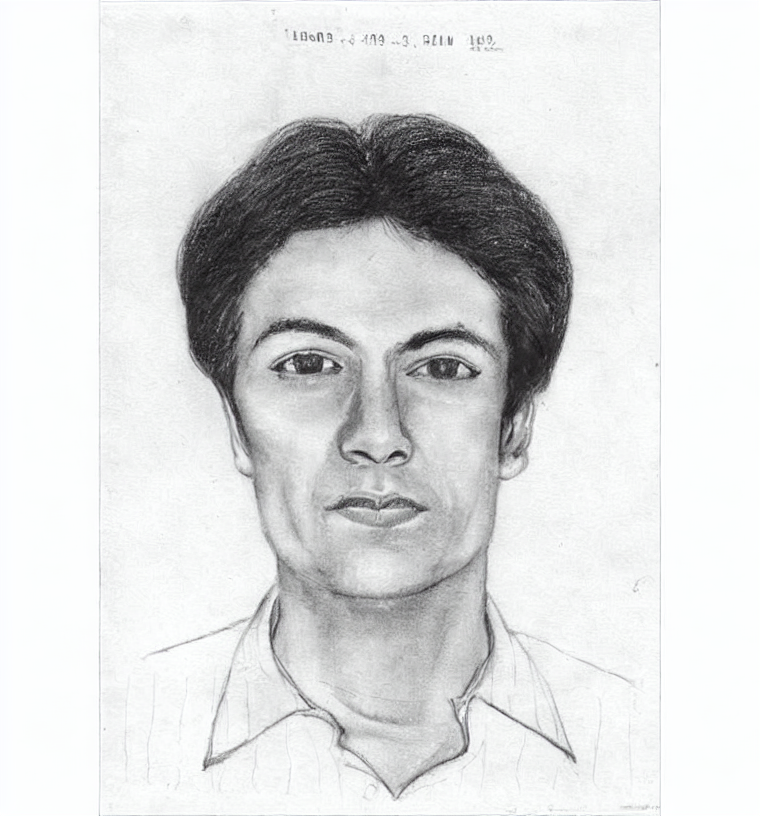

SSIM with input image at iteration 1: 0.7323708376755214
PSNR with input image at iteration 1: 25.063656913909536
LPIPS with input image at iteration 1: 0.02671002596616745
CLIP score for iteration 1: 33.62571716308594
Iteration 2: Generating image with prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes


  0%|          | 0/15 [00:00<?, ?it/s]

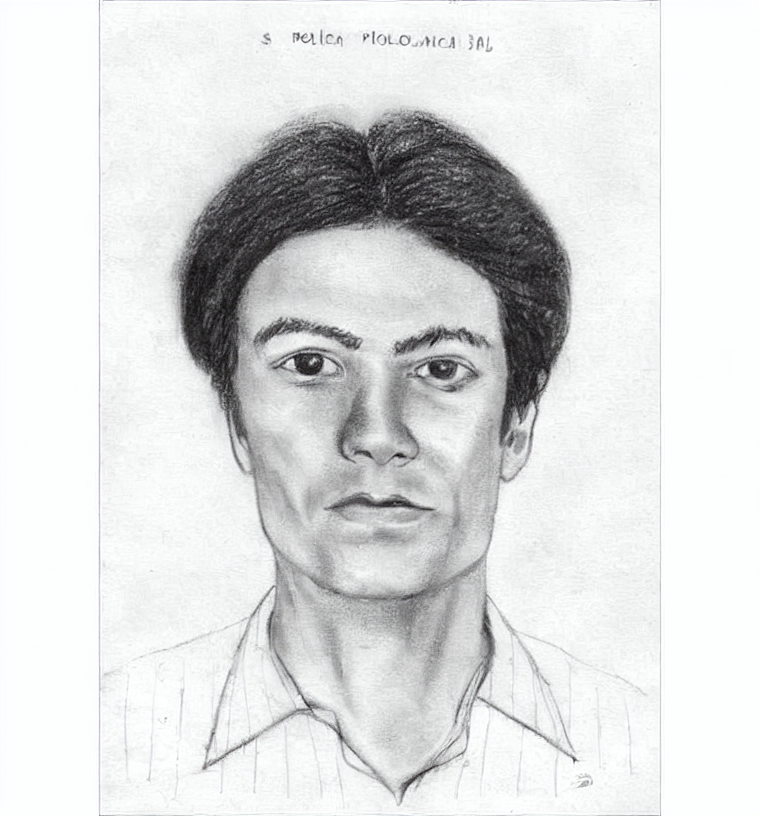

SSIM with input image at iteration 2: 0.7318596931759508
PSNR with input image at iteration 2: 25.1391837924176
LPIPS with input image at iteration 2: 0.025587573647499084
CLIP score for iteration 2: 33.78535079956055
Iteration 3: Generating image with prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes with a more square jawline


  0%|          | 0/15 [00:00<?, ?it/s]

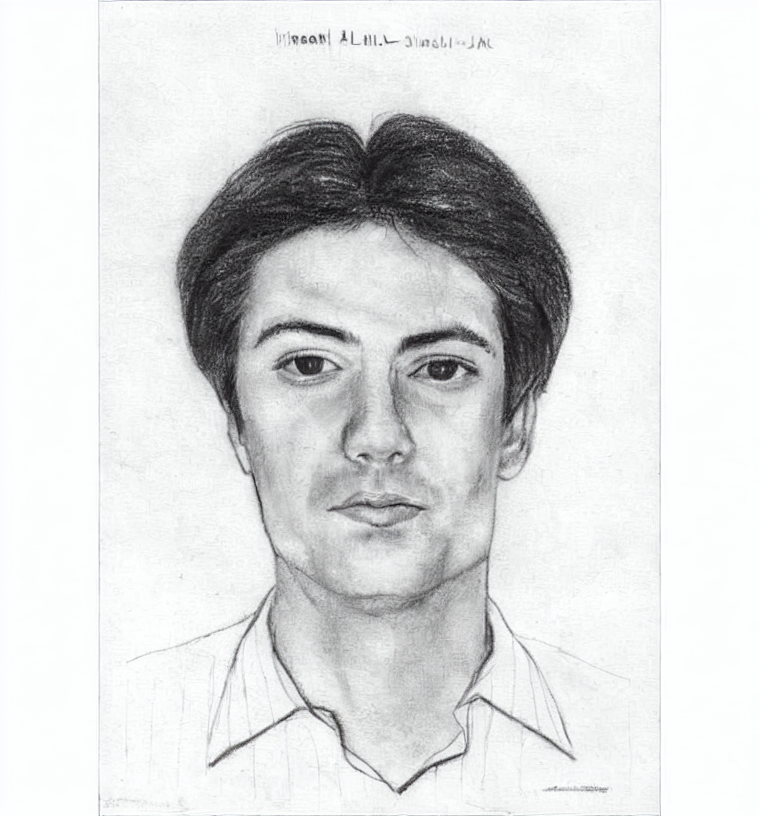

SSIM with input image at iteration 3: 0.7315602842219683
PSNR with input image at iteration 3: 24.953466034604542
LPIPS with input image at iteration 3: 0.029033195227384567
CLIP score for iteration 3: 35.314414978027344
Iteration 4: Generating image with prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes with a more square jawline
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes with a more square jawline with a wider mouth and thinner lips


  0%|          | 0/15 [00:00<?, ?it/s]

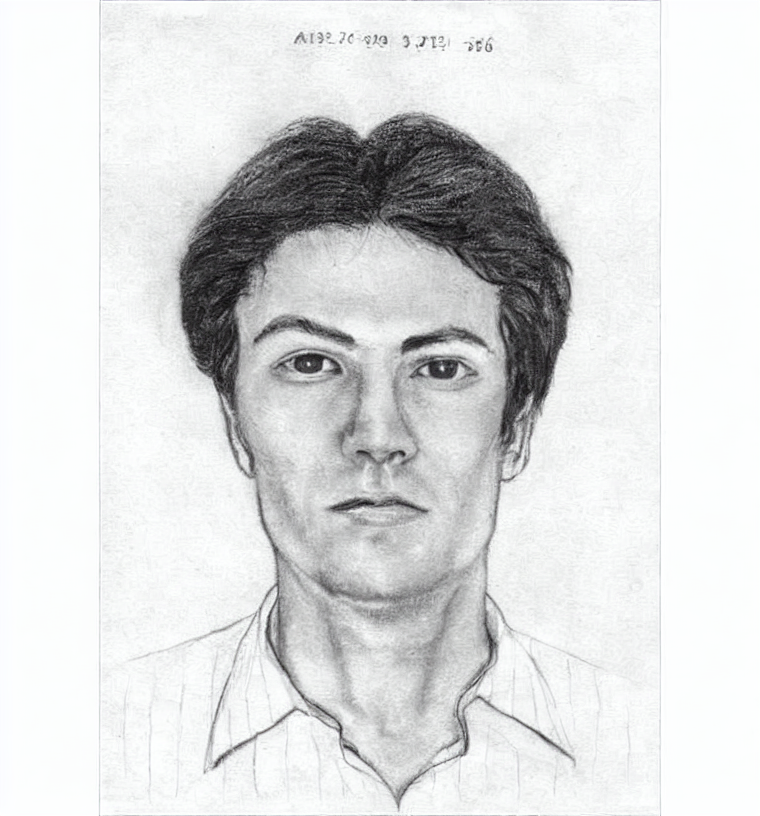

SSIM with input image at iteration 4: 0.7190136167129975
PSNR with input image at iteration 4: 24.68215875639496
LPIPS with input image at iteration 4: 0.02685592696070671
CLIP score for iteration 4: 35.63136291503906
Iteration 5: Generating image with prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes with a more square jawline with a wider mouth and thinner lips
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style a male around 3 0 - 3 5 years old the hairstyle is medium - length , straight hair parted slightly off - center and almond - shaped eyes with a neutral expression mouth with a thinner nose with thinner eyes with a more square jawline with a wider mouth 

  0%|          | 0/15 [00:00<?, ?it/s]

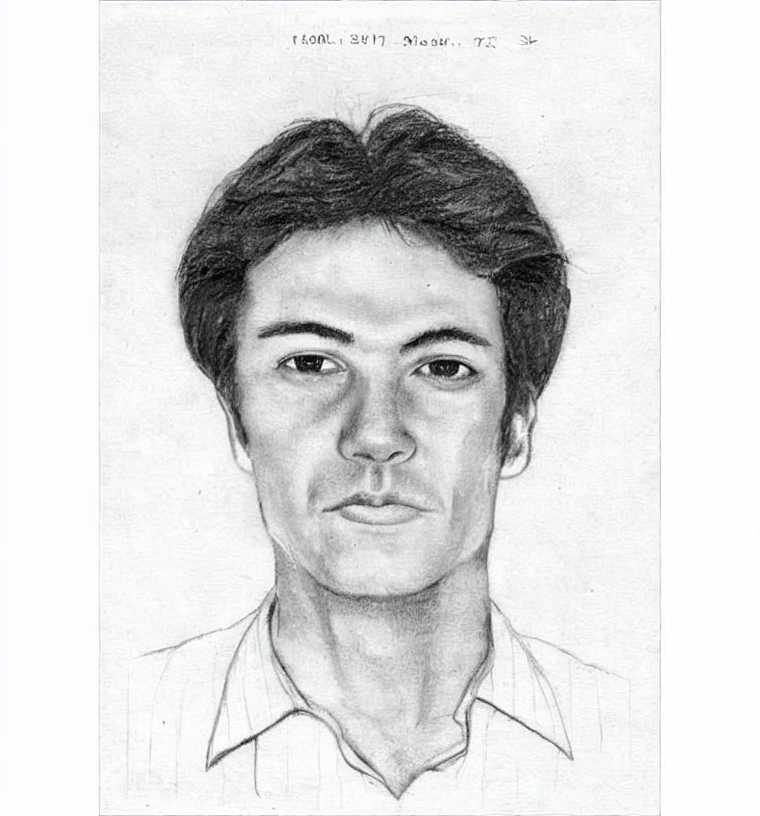

SSIM with input image at iteration 5: 0.7232997325444401
PSNR with input image at iteration 5: 24.551344383022617
LPIPS with input image at iteration 5: 0.02896224334836006
CLIP score for iteration 5: 34.499420166015625

Final Metrics Across Iterations:
SSIM Scores: [0.7323708376755214, 0.7318596931759508, 0.7315602842219683, 0.7190136167129975, 0.7232997325444401]
PSNR Scores: [25.063656913909536, 25.1391837924176, 24.953466034604542, 24.68215875639496, 24.551344383022617]
LPIPS Scores: [0.02671002596616745, 0.025587573647499084, 0.029033195227384567, 0.02685592696070671, 0.02896224334836006]
CLIP Scores: [33.62571716308594, 33.78535079956055, 35.314414978027344, 35.63136291503906, 34.499420166015625]


In [ ]:
input_image_path = "/content/00002.jpg"  # Replace with the path to your input image
prompt = "a male around 30-35 years old The hairstyle is medium-length, straight hair parted slightly off-center and almond-shaped eyes with a neutral expression mouth"

# Process the enhanced prompt and calculate metrics
ssim_scores1, psnr_scores1, lpips_scores1, clip_scores1, generated_images1 = process_enhanced_prompt(input_image_path, prompt)

# Print results
print("\nFinal Metrics Across Iterations:")
print(f"SSIM Scores: {ssim_scores1}")
print(f"PSNR Scores: {psnr_scores1}")
print(f"LPIPS Scores: {lpips_scores1}")
print(f"CLIP Scores: {clip_scores1}")

CLIP to Stable

In [ ]:
# Load CLIP model and processor
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Load Stable Diffusion img2img pipeline
stable_diffusion = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16
).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
projection_layer = nn.Linear(512, 768).to("cuda")

def generate_image_with_sketch_and_embeddings(
    input_image_path, prompt, strength=0.3, guidance_scale=7.5
):
    # Load and preprocess the input sketch
    input_image = Image.open(input_image_path).convert("RGB")

    # Preprocess the image and prompt for CLIP
    inputs = clip_processor(text=[prompt], images=input_image, return_tensors="pt", padding=True)

    # Generate CLIP embeddings
    with torch.no_grad():
        image_features = clip_model.get_image_features(pixel_values=inputs["pixel_values"]).to("cuda")
        text_features = clip_model.get_text_features(input_ids=inputs["input_ids"]).to("cuda")

    # Normalize and combine embeddings
    image_features = image_features / image_features.norm(dim=-1, keepdim=True)
    text_features = text_features / text_features.norm(dim=-1, keepdim=True)
    combined_embeddings = (image_features + text_features) / 2.0

    # Normalize the combined embeddings
    combined_embeddings = (image_features + text_features) / 2.0
    combined_embeddings = combined_embeddings / combined_embeddings.norm(dim=-1, keepdim=True)


    # Project embeddings to match Stable Diffusion's expected dimension
    projected_embeddings = projection_layer(combined_embeddings)

    # Reshape embeddings to match Stable Diffusion's expected shape
    projected_embeddings = projected_embeddings.unsqueeze(1)  # Add seq_len dimension (batch_size, seq_len, embed_dim)

    # Create negative_prompt_embeds (typically all zeros or empty embeddings)
    negative_prompt_embeds = torch.zeros_like(projected_embeddings)

    # Generate the image using the img2img pipeline
    generated_images = stable_diffusion(
        prompt_embeds=projected_embeddings,
        negative_prompt_embeds=negative_prompt_embeds,  # Provide negative embeddings
        image=input_image,  # Ensure this is a PIL.Image.Image object
        strength=strength,  # Control the level of deviation from the input image
        guidance_scale=guidance_scale,  # Control adherence to the prompt
    )["images"]

    return generated_images[0]

def calculate_clip_score(image, text):
    # Ensure the CLIP model is on the correct device
    device = next(clip_model.parameters()).device

    # Preprocess the image and text
    inputs = clip_processor(text=[text], images=image, return_tensors="pt", padding=True).to(device)

    # Ensure tensors match the model's data type
    inputs = {
        key: value.to(dtype=torch.long if key == "input_ids" else clip_model.dtype)
        for key, value in inputs.items()
    }

    # Run the model and calculate the score
    with torch.no_grad():
        outputs = clip_model(**inputs)

    return outputs.logits_per_image.item()


def truncate_prompt_with_addition(base_prompt, addition, max_length=77):
    """
    Truncate the base prompt to fit within the token limit while appending the addition.
    Ensures the resulting prompt is exactly max_length tokens.
    """
    from transformers import CLIPTokenizer
    tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")

    # Tokenize base prompt and addition
    base_tokens = tokenizer(base_prompt, truncation=False, return_tensors="pt")
    addition_tokens = tokenizer(addition, truncation=False, return_tensors="pt")

    # Calculate available space for base prompt after accounting for the addition
    total_tokens = len(base_tokens["input_ids"][0]) + len(addition_tokens["input_ids"][0]) - 1
    if total_tokens > max_length:
        max_base_length = max_length - (len(addition_tokens["input_ids"][0]) - 1)
        base_tokens["input_ids"] = base_tokens["input_ids"][:, :max_base_length]

    # Combine truncated base prompt and addition tokens
    combined_tokens = torch.cat((base_tokens["input_ids"][0], addition_tokens["input_ids"][0][1:]))
    combined_tokens = combined_tokens[:max_length]  # Ensure final truncation to max_length

    # Decode back to prompt text
    truncated_prompt = tokenizer.decode(combined_tokens, skip_special_tokens=True)
    print(f"Updated Prompt: {truncated_prompt}")
    return truncated_prompt

def calculate_ssim(image1, image2):
    image1 = np.array(image1.convert("L"))
    image2 = np.array(image2.convert("L"))
    ssim, _ = compare_ssim(image1, image2, full=True)
    return ssim

def calculate_psnr(image1, image2):
    image1 = np.array(image1)
    image2 = np.array(image2)
    return compare_psnr(image1, image2, data_range=255)

def get_clip_embedding(clip_model, clip_processor, text_prompt, image_path=None, device="cuda"):
    # Compute CLIP embeddings for text and optional image
    if image_path:
        image = Image.open(image_path).convert("RGB")
        inputs = clip_processor(text=[text_prompt], images=image, return_tensors="pt", padding=True).to(device)
    else:
        inputs = clip_processor(text=[text_prompt], return_tensors="pt", padding=True).to(device)

    with torch.no_grad():
        outputs = clip_model(**inputs)

    return outputs.text_embeds  # Use outputs.image_embeds for image embeddings if needed


def project_clip_embedding(clip_embedding, target_dim=768, device="cuda"):
    # Ensure the embedding is compatible with Stable Diffusion
    projection = torch.nn.Linear(clip_embedding.shape[-1], target_dim).to(device)
    return projection(clip_embedding)


def process_with_clip_conditioning(initial_prompt, image_path, device="cuda", num_iterations=5
):
    enhanced_prompt = (
        "highly detailed police sketch, black and white pencil drawing, "
        "professional forensic artist style, detailed shading, "
        f"portrait of {initial_prompt}"
    )
    lpips_model = LPIPS(net="alex").to(device)
    input_image = Image.open(image_path).convert("RGB")
    ssim_scores, psnr_scores, lpips_scores, clip_scores, generated_images = [], [], [], [], []
    latents = None  # Initialize latents

    for i in range(num_iterations):


        # Update the prompt for the next iteration
        if i == 0:
            addition = ", make the hair curlier"
        elif i == 1:
            addition = ", make eyes larger"
        elif i == 2:
            addition = ", make the eyebrows thinner"
        else:
            addition = ", make the jawline more square"

        enhanced_prompt = truncate_prompt_with_addition(enhanced_prompt, addition, max_length=77)


        if i == 0:
          generated_image = generate_image_with_sketch_and_embeddings(
            image_path, enhanced_prompt, strength=0.4, guidance_scale=7.5
          )
          print(f"\nIteration {i + 1}: Generating image with updated prompt...{enhanced_prompt}")
        else:
          generated_image = generate_image_with_sketch_and_embeddings(
            image_path, addition, strength=0.3, guidance_scale=7.5
          )

          print(f"\nIteration {i + 1}: Generating image with updated prompt...{addition}")

        generated_images.append(generated_image)


        display(generated_image)
        generated_image.save(f"output_image_iteration_{i}.png")
        image_path = f"output_image_iteration_{i}.png"

        resized_input_image = input_image.resize(generated_image.size)

        ssim = calculate_ssim(resized_input_image, generated_image)
        psnr = calculate_psnr(resized_input_image, generated_image)
        lpips_value = lpips_model(
            torch.tensor(np.array(resized_input_image)).permute(2, 0, 1).unsqueeze(0).to(device, dtype=torch.float32),
            torch.tensor(np.array(generated_image)).permute(2, 0, 1).unsqueeze(0).to(device, dtype=torch.float32),
        ).item()
        clip_score = calculate_clip_score(generated_image, enhanced_prompt)


        clip_scores.append(clip_score)
        ssim_scores.append(ssim)
        psnr_scores.append(psnr)
        lpips_scores.append(lpips_value)

        print(f"SSIM: {ssim}, PSNR: {psnr}, LPIPS: {lpips_value}, CLIP: {clip_score}")

    return ssim_scores, psnr_scores, lpips_scores, clip_scores, generated_images

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier


  0%|          | 0/20 [00:00<?, ?it/s]


Iteration 1: Generating image with updated prompt...highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier


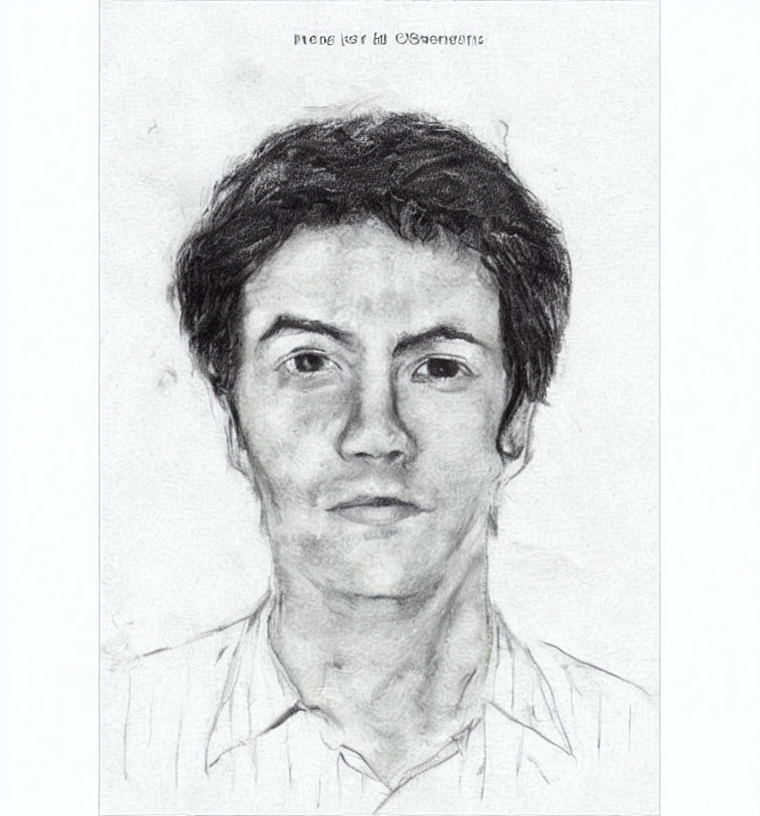

SSIM: 0.6942098674229341, PSNR: 23.426997689497497, LPIPS: 0.034546807408332825, CLIP: 31.15564727783203
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 2: Generating image with updated prompt..., make eyes larger


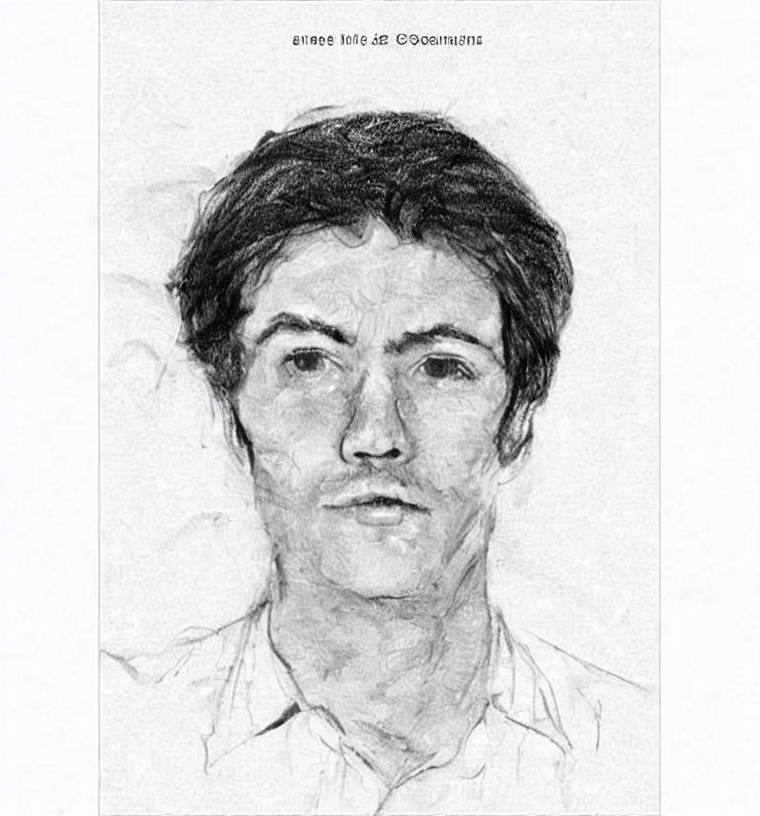

SSIM: 0.644875848934338, PSNR: 21.573751063132953, LPIPS: 0.046862974762916565, CLIP: 30.41704559326172
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger , make the eyebrows thinner


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 3: Generating image with updated prompt..., make the eyebrows thinner


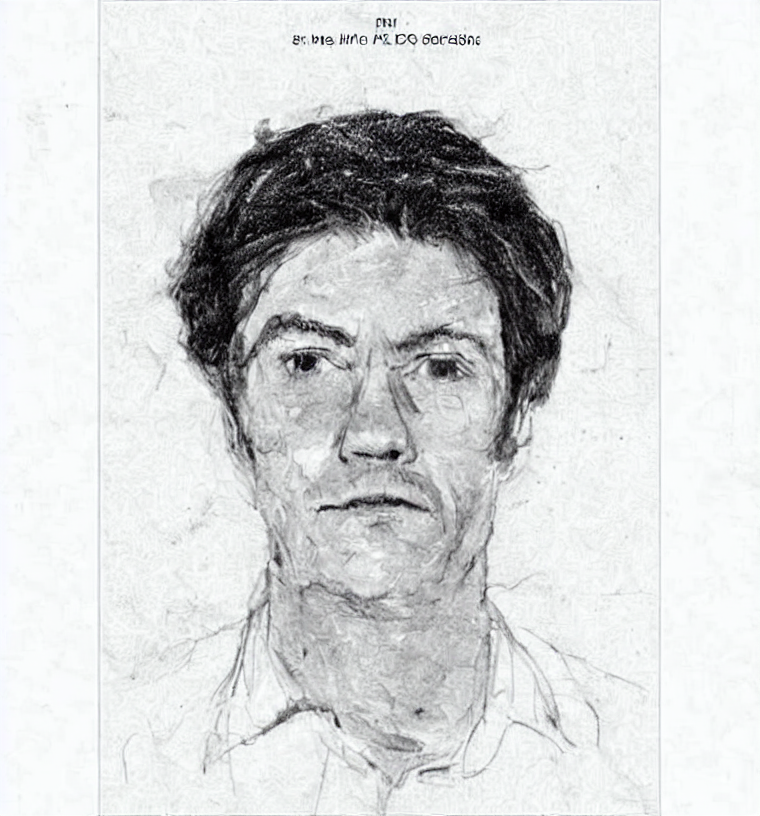

SSIM: 0.6020437304901309, PSNR: 20.27636612107774, LPIPS: 0.05661074444651604, CLIP: 31.012924194335938
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger , make the , make the jawline more square


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 4: Generating image with updated prompt..., make the jawline more square


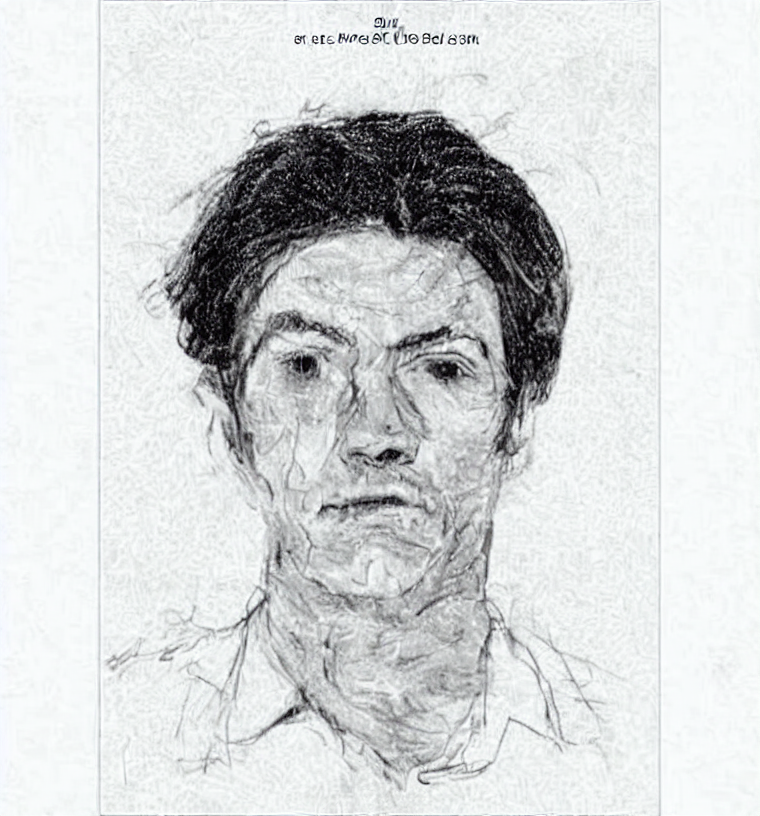

SSIM: 0.5512488461074261, PSNR: 19.370914122838492, LPIPS: 0.0636410191655159, CLIP: 32.30059814453125
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger , make the , make the jawline more square


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 5: Generating image with updated prompt..., make the jawline more square


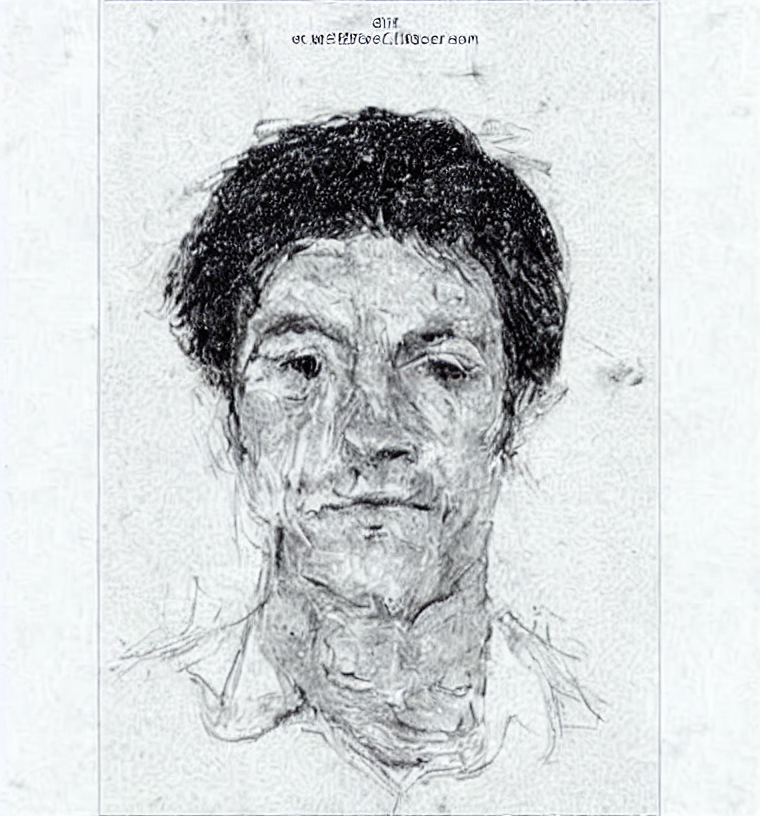

SSIM: 0.5184096667270137, PSNR: 18.195527642608678, LPIPS: 0.07945585995912552, CLIP: 33.453094482421875

Final Metrics Across Iterations:
SSIM Scores: [0.6942098674229341, 0.644875848934338, 0.6020437304901309, 0.5512488461074261, 0.5184096667270137]
PSNR Scores: [23.426997689497497, 21.573751063132953, 20.27636612107774, 19.370914122838492, 18.195527642608678]
LPIPS Scores: [0.034546807408332825, 0.046862974762916565, 0.05661074444651604, 0.0636410191655159, 0.07945585995912552]


In [ ]:
# Input text prompt and image
text_prompt = "The person is described as male around 30-35 years old with an oval face, defined cheekbones, medium-length straight hair, and light skin tone."
image_path = "/content/00002.jpg"

# Generate images with CLIP embedding conditioning
ssim_scores2, psnr_scores2, lpips_scores2, clip_scores2, generated_images2 = process_with_clip_conditioning(
    text_prompt, image_path, num_iterations=5
)

# Print metrics
print("\nFinal Metrics Across Iterations:")
print(f"SSIM Scores: {ssim_scores2}")
print(f"PSNR Scores: {psnr_scores2}")
print(f"LPIPS Scores: {lpips_scores2}")

Finetuned to Stable

In [ ]:
device = "cuda"
projection_layer = nn.Linear(512, 768).to("cuda")

class LoRALinear(nn.Module):
    def __init__(self, original_linear, r, lora_alpha, lora_dropout):
        super().__init__()
        self.original_linear = original_linear
        self.r = r
        self.lora_alpha = lora_alpha
        self.lora_dropout = nn.Dropout(lora_dropout)
        self.lora_A = nn.Parameter(torch.zeros(original_linear.in_features, r))
        self.lora_B = nn.Parameter(torch.zeros(r, original_linear.out_features))
        self.scaling = lora_alpha / r

        # Initialize parameters
        nn.init.normal_(self.lora_A, std=0.02)
        nn.init.normal_(self.lora_B, std=0.02)

    def forward(self, x):
        result = self.original_linear(x)
        if self.r > 0:
            lora_result = (self.lora_dropout(x) @ self.lora_A @ self.lora_B) * self.scaling
            return result + lora_result
        return result


def apply_lora_to_model(model, r=16, lora_alpha=32, lora_dropout=0.1):
    for name, module in model.named_modules():
        if isinstance(module, nn.Linear) and any(substr in name for substr in ['q_proj', 'v_proj', 'k_proj']):
            parent = model
            for name_part in name.split('.')[:-1]:
                parent = getattr(parent, name_part)
            layer_name = name.split('.')[-1]
            setattr(parent, layer_name, LoRALinear(module, r, lora_alpha, lora_dropout))

def setup_clip_model(checkpoint_path, device):
    model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
    processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
    apply_lora_to_model(model)  # Apply LoRA modifications
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'], strict=True)
    model = model.to(device).eval()
    return model, processor


def generate_image_with_sketch_and_embeddings(
    input_image_path, prompt, clip_model, clip_processor, stable_diffusion, strength=0.3, guidance_scale=7.5
):
    input_image = Image.open(input_image_path).convert("RGB")

    # Preprocess the image and prompt for CLIP
    inputs = clip_processor(text=[prompt], images=input_image, return_tensors="pt", padding=True).to(device)

    # Generate CLIP embeddings
    with torch.no_grad():
        image_features = clip_model.get_image_features(pixel_values=inputs["pixel_values"])
        text_features = clip_model.get_text_features(input_ids=inputs["input_ids"])

    # Normalize and combine embeddings
    image_features = image_features / image_features.norm(dim=-1, keepdim=True)
    text_features = text_features / text_features.norm(dim=-1, keepdim=True)
    combined_embeddings = (image_features + text_features) / 2.0
    combined_embeddings = combined_embeddings / combined_embeddings.norm(dim=-1, keepdim=True)

    # Project embeddings to match Stable Diffusion's expected dimension
    projected_embeddings = projection_layer(combined_embeddings)

    # Reshape embeddings to match Stable Diffusion's expected shape
    projected_embeddings = projected_embeddings.unsqueeze(1)  # Add seq_len dimension (batch_size, seq_len, embed_dim)

    # Create negative_prompt_embeds (typically all zeros or empty embeddings)
    negative_prompt_embeds = torch.zeros_like(projected_embeddings)


    # Generate the image using the Stable Diffusion pipeline
    generated_images = stable_diffusion(
          prompt_embeds=projected_embeddings,
          negative_prompt_embeds=negative_prompt_embeds,  # Provide negative embeddings
          image=input_image,  # Ensure this is a PIL.Image.Image object
          strength=strength,  # Control the level of deviation from the input image
          guidance_scale=guidance_scale,  # Control adherence to the prompt
      )["images"]

    return generated_images[0]

def calculate_clip_score(clip_model, clip_processor, image, text):
    # Ensure the CLIP model is on the correct device
    device = next(clip_model.parameters()).device

    # Preprocess the image and text
    inputs = clip_processor(text=[text], images=image, return_tensors="pt", padding=True).to(device)

    # Ensure tensors match the model's data type
    inputs = {
        key: value.to(dtype=torch.long if key == "input_ids" else clip_model.dtype)
        for key, value in inputs.items()
    }

    # Run the model and calculate the score
    with torch.no_grad():
        outputs = clip_model(**inputs)

    return outputs.logits_per_image.item()


def truncate_prompt_with_addition(base_prompt, addition, max_length=77):
    """
    Truncate the base prompt to fit within the token limit while appending the addition.
    Ensures the resulting prompt is exactly max_length tokens.
    """
    from transformers import CLIPTokenizer
    tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")

    # Tokenize base prompt and addition
    base_tokens = tokenizer(base_prompt, truncation=False, return_tensors="pt")
    addition_tokens = tokenizer(addition, truncation=False, return_tensors="pt")

    # Calculate available space for base prompt after accounting for the addition
    total_tokens = len(base_tokens["input_ids"][0]) + len(addition_tokens["input_ids"][0]) - 1
    if total_tokens > max_length:
        max_base_length = max_length - (len(addition_tokens["input_ids"][0]) - 1)
        base_tokens["input_ids"] = base_tokens["input_ids"][:, :max_base_length]

    # Combine truncated base prompt and addition tokens
    combined_tokens = torch.cat((base_tokens["input_ids"][0], addition_tokens["input_ids"][0][1:]))
    combined_tokens = combined_tokens[:max_length]  # Ensure final truncation to max_length

    # Decode back to prompt text
    truncated_prompt = tokenizer.decode(combined_tokens, skip_special_tokens=True)
    print(f"Updated Prompt: {truncated_prompt}")
    return truncated_prompt

def calculate_ssim(image1, image2):
    image1 = np.array(image1.convert("L"))
    image2 = np.array(image2.convert("L"))
    ssim, _ = compare_ssim(image1, image2, full=True)
    return ssim

def calculate_psnr(image1, image2):
    image1 = np.array(image1)
    image2 = np.array(image2)
    return compare_psnr(image1, image2, data_range=255)

def get_clip_embedding(clip_model, clip_processor, text_prompt, image_path=None, device="cuda"):
    # Compute CLIP embeddings for text and optional image
    if image_path:
        image = Image.open(image_path).convert("RGB")
        inputs = clip_processor(text=[text_prompt], images=image, return_tensors="pt", padding=True).to(device)
    else:
        inputs = clip_processor(text=[text_prompt], return_tensors="pt", padding=True).to(device)

    with torch.no_grad():
        outputs = clip_model(**inputs)

    return outputs.text_embeds  # Use outputs.image_embeds for image embeddings if needed


def project_clip_embedding(clip_embedding, target_dim=768, device="cuda"):
    # Ensure the embedding is compatible with Stable Diffusion
    projection = torch.nn.Linear(clip_embedding.shape[-1], target_dim).to(device)
    return projection(clip_embedding)


def process_with_clip_conditioning(initial_prompt, image_path, clip_model, clip_processor, stable_diffusion,  device="cuda", num_iterations=5
):
    enhanced_prompt = (
        "highly detailed police sketch, black and white pencil drawing, "
        "professional forensic artist style, detailed shading, "
        f"portrait of {initial_prompt}"
    )
    lpips_model = LPIPS(net="alex").to(device)
    input_image = Image.open(image_path).convert("RGB")
    ssim_scores, psnr_scores, lpips_scores, clip_scores, generated_images = [], [], [], [], []
    latents = None  # Initialize latents

    for i in range(num_iterations):


        # Update the prompt for the next iteration
        if i == 0:
            addition = ", make the hair curlier"
        elif i == 1:
            addition = ", make eyes larger"
        elif i == 2:
            addition = ", make the eyebrows thinner"
        else:
            addition = ", make the jawline more square"

        enhanced_prompt = truncate_prompt_with_addition(enhanced_prompt, addition, max_length=77)


        if i == 0:
          generated_image = generate_image_with_sketch_and_embeddings(
            image_path, enhanced_prompt, clip_model, clip_processor, stable_diffusion, strength=0.4, guidance_scale=7.5
          )
          print(f"\nIteration {i + 1}: Generating image with updated prompt...{enhanced_prompt}")
        else:
          generated_image = generate_image_with_sketch_and_embeddings(
            image_path, addition, clip_model, clip_processor, stable_diffusion, strength=0.3, guidance_scale=7.5
          )

          print(f"\nIteration {i + 1}: Generating image with updated prompt...{addition}")

        generated_images.append(generated_image)


        display(generated_image)
        generated_image.save(f"output_image_iteration_{i}.png")
        image_path = f"output_image_iteration_{i}.png"

        resized_input_image = input_image.resize(generated_image.size)

        ssim = calculate_ssim(resized_input_image, generated_image)
        psnr = calculate_psnr(resized_input_image, generated_image)
        lpips_value = lpips_model(
            torch.tensor(np.array(resized_input_image)).permute(2, 0, 1).unsqueeze(0).to(device, dtype=torch.float32),
            torch.tensor(np.array(generated_image)).permute(2, 0, 1).unsqueeze(0).to(device, dtype=torch.float32),
        ).item()
        clip_score = calculate_clip_score(clip_model, clip_processor, generated_image, enhanced_prompt)


        clip_scores.append(clip_score)
        ssim_scores.append(ssim)
        psnr_scores.append(psnr)
        lpips_scores.append(lpips_value)

        print(f"SSIM: {ssim}, PSNR: {psnr}, LPIPS: {lpips_value}, CLIP: {clip_score}")

    return ssim_scores, psnr_scores, lpips_scores, clip_scores, generated_images

<ipython-input-15-aa7d6ac80e73>:40: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier


  0%|          | 0/20 [00:00<?, ?it/s]


Iteration 1: Generating image with updated prompt...highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier


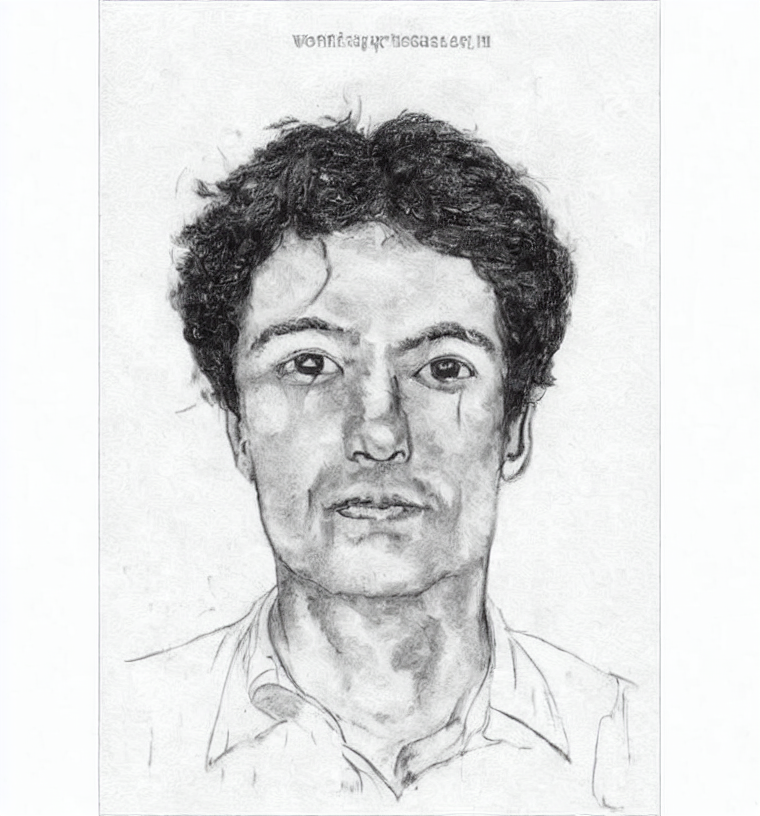

SSIM: 0.6910359075880399, PSNR: 22.730888681608864, LPIPS: 0.03821813687682152, CLIP: 36.4468994140625
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 2: Generating image with updated prompt..., make eyes larger


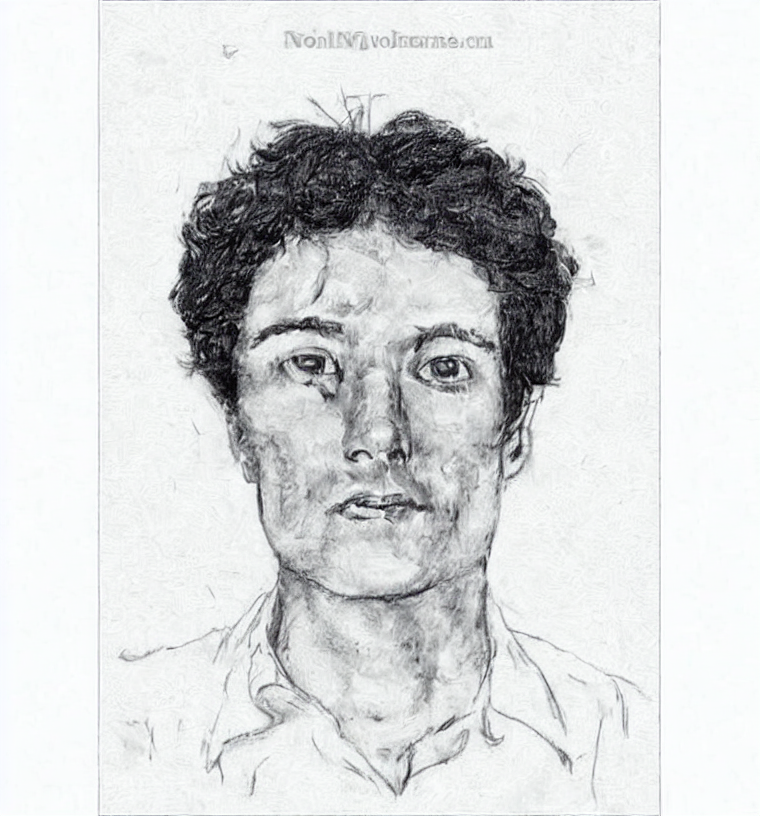

SSIM: 0.6413919503530505, PSNR: 20.912824875654866, LPIPS: 0.053498584777116776, CLIP: 36.25471115112305
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger , make the eyebrows thinner


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 3: Generating image with updated prompt..., make the eyebrows thinner


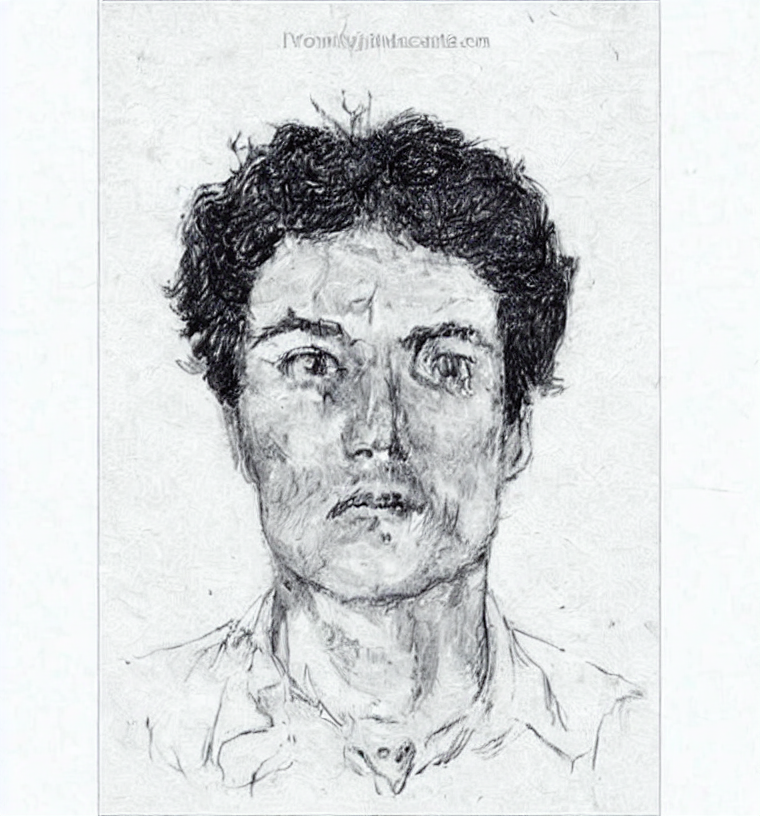

SSIM: 0.6066795400724917, PSNR: 19.7784286280867, LPIPS: 0.06187785416841507, CLIP: 37.69740295410156
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger , make the , make the jawline more square


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 4: Generating image with updated prompt..., make the jawline more square


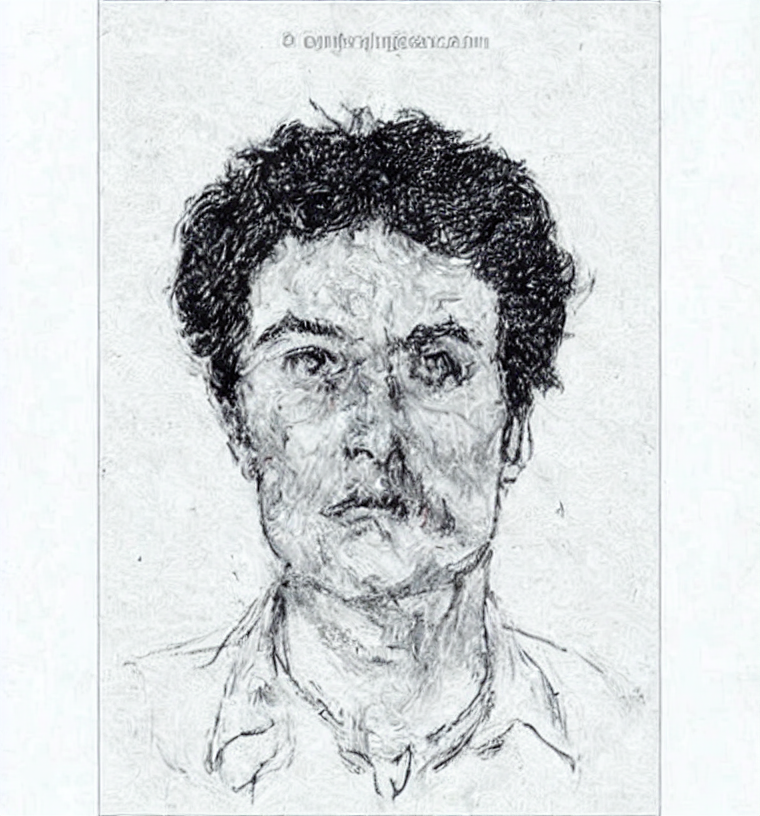

SSIM: 0.5652848360590282, PSNR: 18.54767262829094, LPIPS: 0.07193554937839508, CLIP: 31.263519287109375
Updated Prompt: highly detailed police sketch , black and white pencil drawing , professional forensic artist style , detailed shading , portrait of the person is described as male around 3 0 - 3 5 years old with an oval face , defined cheekbones , medium - length straight hair , and light skin tone . , make the hair curlier , make eyes larger , make the , make the jawline more square


  0%|          | 0/15 [00:00<?, ?it/s]


Iteration 5: Generating image with updated prompt..., make the jawline more square


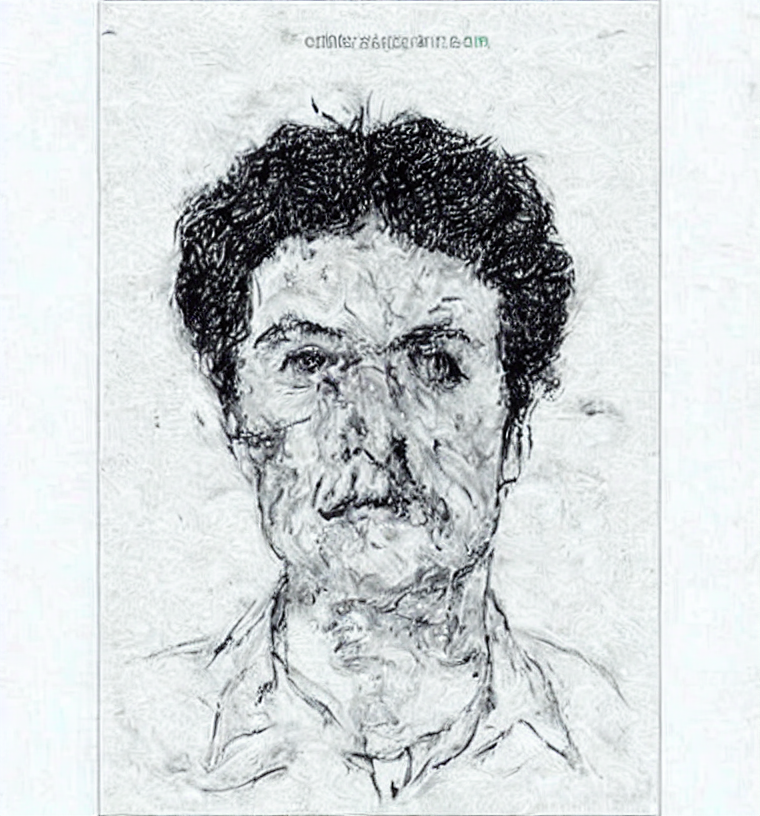

SSIM: 0.5343311107927108, PSNR: 17.538889350772788, LPIPS: 0.08639056235551834, CLIP: 28.448474884033203

Final Metrics Across Iterations:
SSIM Scores: [0.6910359075880399, 0.6413919503530505, 0.6066795400724917, 0.5652848360590282, 0.5343311107927108]
PSNR Scores: [22.730888681608864, 20.912824875654866, 19.7784286280867, 18.54767262829094, 17.538889350772788]
LPIPS Scores: [0.03821813687682152, 0.053498584777116776, 0.06187785416841507, 0.07193554937839508, 0.08639056235551834]


In [ ]:
text_prompt = "The person is described as male around 30-35 years old with an oval face, defined cheekbones, medium-length straight hair, and light skin tone."
image_path = "/content/00002.jpg"

checkpoint_path = "/content/drive/My Drive/clip_checkpoint_epoch_20.pt"
clip_model, clip_processor = setup_clip_model(checkpoint_path, device)
stable_diffusion = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16
).to("cuda")

# Generate images with CLIP embedding conditioning
ssim_scores3, psnr_scores3, lpips_scores3, clip_scores3, generated_images3 = process_with_clip_conditioning(
    text_prompt, image_path, clip_model, clip_processor, stable_diffusion
)

# Print metrics
print("\nFinal Metrics Across Iterations:")
print(f"SSIM Scores: {ssim_scores3}")
print(f"PSNR Scores: {psnr_scores3}")
print(f"LPIPS Scores: {lpips_scores3}")

In [ ]:
from google.colab import drive
import torch

# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


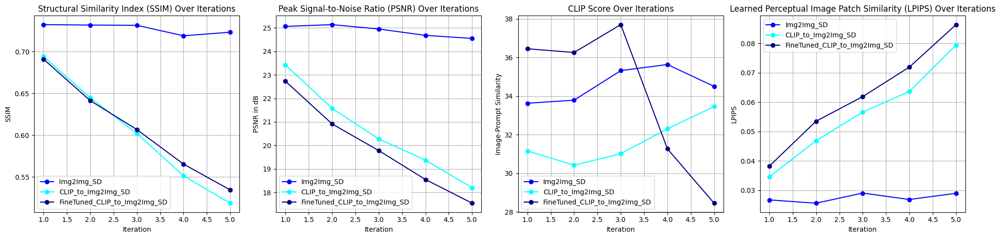

In [ ]:
iterations = [1, 2, 3, 4, 5]

# Create subplots
plt.figure(figsize=(20, 5))

# SSIM Plot
plt.subplot(1, 4, 1)
plt.plot(iterations, ssim_scores1, label="Img2Img_SD ", marker="o", color="blue")
plt.plot(iterations, ssim_scores2, label="CLIP_to_Img2Img_SD", marker="o", color="cyan")
plt.plot(iterations, ssim_scores3, label="FineTuned_CLIP_to_Img2Img_SD", marker="o", color="navy")
plt.xlabel("Iteration")
plt.ylabel("SSIM")
plt.title("Structural Similarity Index (SSIM) Over Iterations")
plt.grid(True)
plt.legend()

# PSNR Plot
plt.subplot(1, 4, 2)
plt.plot(iterations, psnr_scores1, label="Img2Img_SD", marker="o", color="blue")
plt.plot(iterations, psnr_scores2, label="CLIP_to_Img2Img_SD", marker="o", color="cyan")
plt.plot(iterations, psnr_scores3, label="FineTuned_CLIP_to_Img2Img_SD", marker="o", color="navy")
plt.xlabel("Iteration")
plt.ylabel("PSNR in dB")
plt.title("Peak Signal-to-Noise Ratio (PSNR) Over Iterations")
plt.grid(True)
plt.legend()

# CLIP Score Plot
plt.subplot(1, 4, 3)
plt.plot(iterations, clip_scores1, label="Img2Img_SD", marker='o', color='blue')
plt.plot(iterations, clip_scores2, label="CLIP_to_Img2Img_SD", marker='o', color='cyan')
plt.plot(iterations, clip_scores3, label="FineTuned_CLIP_to_Img2Img_SD", marker='o', color='navy')
plt.xlabel("Iteration")
plt.ylabel("Image-Prompt Similarity")
plt.title("CLIP Score Over Iterations")
plt.grid(True)
plt.legend()

# LPIPS Plot
plt.subplot(1, 4, 4)
plt.plot(iterations, lpips_scores1, label="Img2Img_SD", marker="o", color="blue")
plt.plot(iterations, lpips_scores2, label="CLIP_to_Img2Img_SD", marker="o", color="cyan")
plt.plot(iterations, lpips_scores3, label="FineTuned_CLIP_to_Img2Img_SD", marker="o", color="navy")
plt.xlabel("Iteration")
plt.ylabel("LPIPS")
plt.title("Learned Perceptual Image Patch Similarity (LPIPS) Over Iterations")
plt.grid(True)
plt.legend()

# Show the plots
plt.tight_layout()
plt.show()

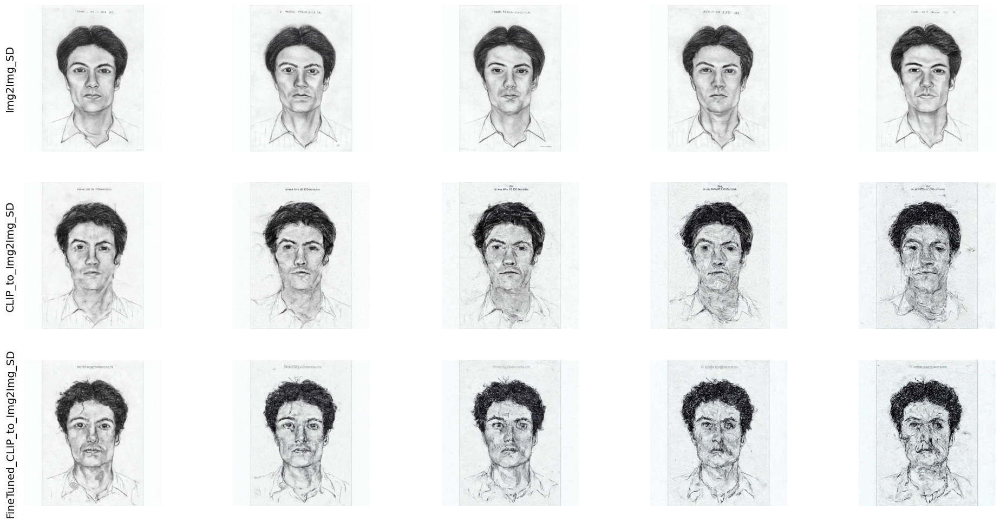

In [ ]:
model_names = ["Img2Img_SD", "CLIP_to_Img2Img_SD", "FineTuned_CLIP_to_Img2Img_SD"]
all_generated_images = [generated_images1, generated_images2, generated_images3]

# Create the figure with 3 rows
num_images = len(generated_images1)
plt.figure(figsize=(20, 10))

for row_idx, (model_name, images) in enumerate(zip(model_names, all_generated_images)):
    for i, img in enumerate(images):
        plt.subplot(len(all_generated_images), num_images, row_idx * num_images + i + 1)
        plt.imshow(img)
        plt.axis("off")
        if i == 0:  # Label the row with the model name
            plt.text(
                -0.1, 0.5, model_name,
                fontsize=14, ha='center', va='center',
                rotation=90, transform=plt.gca().transAxes
            )

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
# Model names
model_names = ["Img2Img_SD", "CLIP_to_Img2Img_SD", "FineTuned_CLIP_to_Img2Img_SD"]

# Calculate average change in CLIP score for each model
clip_scores = [clip_scores1, clip_scores2, clip_scores3]
average_changes = []

for scores in clip_scores:
    changes = [scores[i + 1] - scores[i] for i in range(len(scores) - 1)]
    average_change = sum(changes) / len(changes)
    average_changes.append(average_change)

# Display the results with model names
average_changes_dict = {model_name: change for model_name, change in zip(model_names, average_changes)}
average_changes_dict


{'Img2Img_SD': 0.21842575073242188,
 'CLIP_to_Img2Img_SD': 0.5743618011474609,
 'FineTuned_CLIP_to_Img2Img_SD': -1.9996061325073242}

In [ ]:
# Calculate average change in LPIPS score for each model
lpips_scores = [lpips_scores1, lpips_scores2, lpips_scores3]
average_changes_lpips = []

for scores in lpips_scores:
    changes = [scores[i + 1] - scores[i] for i in range(len(scores) - 1)]
    average_change = sum(changes) / len(changes)
    average_changes_lpips.append(average_change)

# Display the results with model names
average_changes_lpips_dict = {model_name: change for model_name, change in zip(model_names, average_changes_lpips)}
average_changes_lpips_dict


{'Img2Img_SD': 0.0005630543455481529,
 'CLIP_to_Img2Img_SD': 0.011227263137698174,
 'FineTuned_CLIP_to_Img2Img_SD': 0.012043106369674206}

In [ ]:
average_changes = []

# Calculate the average change in CLIP scores for each model
for scores in clip_scores:
    changes = [scores[i + 1] - scores[i] for i in range(len(scores) - 1)]
    average_change = sum(changes) / len(changes)
    average_changes.append(average_change)

# Create a dictionary to map model names to their average changes
average_changes_dict = {model_name: change for model_name, change in zip(model_names, average_changes)}

# Display the results
print("Average Change in CLIP Scores for Each Model:")
for model_name, change in average_changes_dict.items():
    print(f"{model_name}: {change:.4f}")

# Compare the first model against the others
improvements = {
    f"{model_names[0]} vs {model_names[i]}": average_changes[0] - average_changes[i]
    for i in range(1, len(model_names))
}

print("\nImprovement of First Model Over Others:")
for comparison, improvement in improvements.items():
    print(f"{comparison}: {improvement:.4f}")

Average Change in CLIP Scores for Each Model:
Img2Img_SD: 0.2184
CLIP_to_Img2Img_SD: 0.5744
FineTuned_CLIP_to_Img2Img_SD: -1.9996

Improvement of First Model Over Others:
Img2Img_SD vs CLIP_to_Img2Img_SD: -0.3559
Img2Img_SD vs FineTuned_CLIP_to_Img2Img_SD: 2.2180


In [ ]:
psnr_scores = [psnr_scores1, psnr_scores2, psnr_scores3]

average_scores = [sum(scores) / len(scores) for scores in psnr_scores]

# Calculate how much better the first model performs in percentage
performance_percentages = [
    100 * (average_scores[0] - avg_score) / avg_score for avg_score in average_scores[1:]
]

# Print percentage improvements
print("Percentage Improvement of Img2Img_SD Over Other Models:")
for i, percentage in enumerate(performance_percentages):
    print(f"{model_names[0]} vs {model_names[i + 1]}: {percentage:.2f}%")

Percentage Improvement of Img2Img_SD Over Other Models:
Img2Img_SD vs CLIP_to_Img2Img_SD: 20.95%
Img2Img_SD vs FineTuned_CLIP_to_Img2Img_SD: 25.00%
